<a href="https://colab.research.google.com/github/Kylef94/Bear-classifier/blob/main/train.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install fastbook
from fastbook import *
import os

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 719.8/719.8 kB 7.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.1/7.1 MB 66.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 474.6/474.6 kB 31.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 56.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.5/110.5 kB 11.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.5/212.5 kB 13.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.3/134.3 kB 11.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 24.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 24.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 110.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.5/114.5 kB 5.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━

In [22]:
from fastai.vision.widgets import *

In [2]:
key = os.environ.get('AZURE_SEARCH_KEY', '8feced4d3ec0416ea99fa0b47489f850')

In [3]:
search_images_bing

<function fastbook.search_images_bing(key, term, min_sz=128, max_images=150)>

In [4]:
results = search_images_bing(key, 'grizzly bear')
ims = results.attrgot('contentUrl')
len(ims)

149

In [5]:
ims[0]

'https://tetonvalleylodge.com/wp-content/uploads/2015/04/grizzly-bear-idaho.jpg'

In [34]:
dest = 'images/grizzly.jpg'
download_url(ims[0], dest)

Path('images/grizzly.jpg')

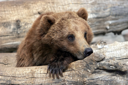

In [7]:
im = Image.open(dest)
im.to_thumb(128,128)

In [8]:
bear_types = 'grizzly', 'black', 'teddy'
path = Path('bears')

In [9]:
if not path.exists():
  path.mkdir()
for o in bear_types:
  dest = (path/o)
  dest.mkdir(exist_ok=True)
  results = search_images_bing(key, f'{o} bear')
  download_images(dest, urls=results.attrgot('contentUrl'))

In [10]:
fns = get_image_files(path)
fns

(#435) [Path('bears/teddy/0f1be043-4e15-4015-a385-f716862570d0.jpg'),Path('bears/teddy/2f611c97-788e-491c-a609-af3c01108191.jpg'),Path('bears/teddy/8b91c1ef-334a-49da-a33f-890872086bce.JPG'),Path('bears/teddy/692f3a0b-695e-4a03-8b01-df6c61ba46d4.jpg'),Path('bears/teddy/51fa162a-e652-44df-9c92-fd61ddcb3d4d.jpg'),Path('bears/teddy/f9868793-1726-4c29-86d5-e5d3388037c0.jpg'),Path('bears/teddy/b3becc6b-6115-40be-925f-d5d0d817bc9a.jpg'),Path('bears/teddy/e2cf4f8d-5a99-4881-adea-b36e8e072ff8.jpg'),Path('bears/teddy/105b49f1-95d6-4ec4-95b1-c925bb9710bf.JPG'),Path('bears/teddy/4eedf029-b25a-4201-af9c-27d9ec4a2cd9.jpg')...]

In [11]:
failed = verify_images(fns)
failed

(#18) [Path('bears/teddy/8b91c1ef-334a-49da-a33f-890872086bce.JPG'),Path('bears/teddy/5c6b07d3-4db4-43c5-93e9-4ab68a4787dc.jpg'),Path('bears/teddy/06c1ff83-6c3e-42a5-a230-bf29052125d4.JPG'),Path('bears/teddy/5a9f6af1-3f58-4dc2-b469-0fead0c448d5.jpg'),Path('bears/teddy/b9c4a38d-e26d-4978-94a6-a692ab5904a6.JPG'),Path('bears/teddy/bdfd6dc0-8e82-4454-9d2b-89cc5146d5d9.jpg'),Path('bears/teddy/038fc3b2-a256-493a-889b-fc128e3b445d.JPG'),Path('bears/teddy/0643d56a-c9d2-44d4-a05c-84749d9ae1dc.JPG'),Path('bears/teddy/594bab70-db7e-4097-abea-563ab7420d98.JPG'),Path('bears/teddy/a3e97dde-37f1-40a8-a256-c7dc4c6cf909.jpg')...]

In [12]:
failed.map(Path.unlink)

(#18) [None,None,None,None,None,None,None,None,None,None...]

In [13]:
bears = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
  get_items=get_image_files,
  splitter=RandomSplitter(valid_pct=0.2, seed=42),
  get_y=parent_label,
  item_tfms=Resize(128)
)

In [14]:
dls = bears.dataloaders(path)

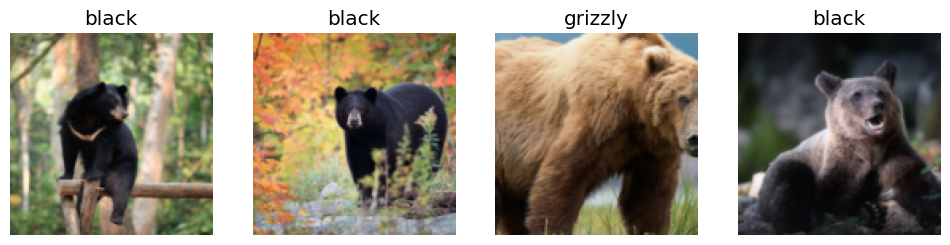

In [15]:
dls.valid.show_batch(max_n=4, nrows=1)

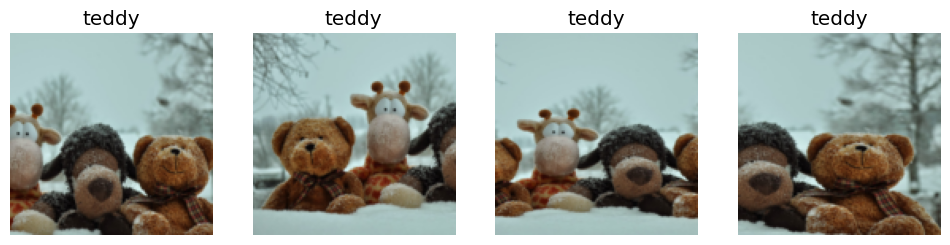

In [16]:
bears = bears.new(item_tfms=RandomResizedCrop(128, min_scale=0.3))
dls = bears.dataloaders(path)
dls.train.show_batch(max_n=4, nrows=1, unique=True)

In [26]:
bears = bears.new(
    item_tfms=RandomResizedCrop(128, min_scale=0.3),
    batch_tfms=aug_transforms())
dls = bears.dataloaders(path)

In [18]:
learn= vision_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(4)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 221MB/s]


epoch,train_loss,valid_loss,error_rate,time
0,1.574132,0.532597,0.120482,00:28


epoch,train_loss,valid_loss,error_rate,time
0,0.500144,0.231522,0.036145,00:26
1,0.372371,0.318932,0.036145,00:27
2,0.291301,0.340488,0.060241,00:27
3,0.257214,0.332758,0.060241,00:27


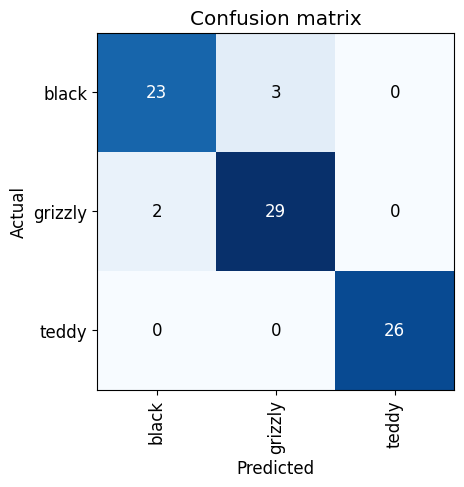

In [19]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

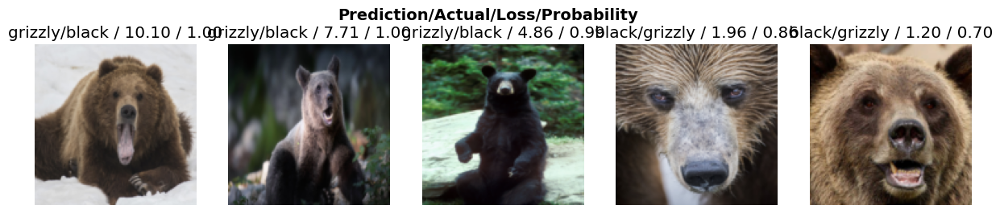

In [20]:
interp.plot_top_losses(5, nrows=1)

In [23]:
cleaner = ImageClassifierCleaner(learn)
cleaner

In [24]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()
for idx,cat in cleaner.change(): shutil.move(str(cleaner.fns[idx]), path/cat)
     

In [27]:
learn= vision_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(4)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,error_rate,time
0,1.607543,0.108471,0.060241,00:29


epoch,train_loss,valid_loss,error_rate,time
0,0.459664,0.087424,0.036145,00:26
1,0.354072,0.093800,0.024096,00:28
2,0.296659,0.116866,0.048193,00:26
3,0.235680,0.128206,0.048193,00:26


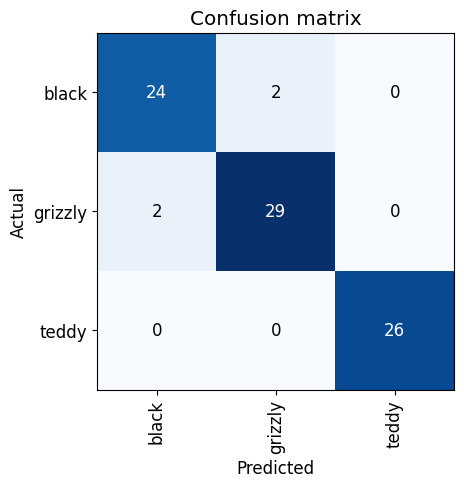

In [28]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

In [29]:
learn.export()

In [30]:
path=Path()
path.ls(file_exts='.pkl')

(#1) [Path('export.pkl')]

In [31]:
learn_inf = load_learner(path/'export.pkl')

In [36]:
learn_inf.predict('images/grizzly.jpg')

('grizzly', tensor(1), tensor([3.8391e-06, 9.9999e-01, 7.4549e-06]))